Sources:

https://github.com/Coding-Crashkurse/RAG-Evaluation-with-Ragas/blob/main/ragas.ipynb
https://www.youtube.com/watch?v=aeae-sITqEA

In [3]:
!pip install langchain langchain-community


[notice] A new release of pip available: 22.3 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


Youtube Link:
https://www.youtube.com/watch?v=aeae-sITqEA

In [1]:
# SIMULATING THE APP HERE, ONLY FOR 1 DOCUMENT
from langchain_community.document_loaders import PyPDFLoader
from langchain_text_splitters import RecursiveCharacterTextSplitter
data_path = "Aspect Detection and Sentiment Classification using Deep Neural Network for Indonesian Aspect-Based Sentiment Analysis.pdf"

print("Loading PDF...")
loader = PyPDFLoader(data_path)
pages = loader.load()

for page in pages:
  page.metadata['file_name'] = page.metadata['source']

print(f"PDF loaded: {data_path}...")

print("Splitting text...")
# Initialize the RecursiveCharacterTextSplitter for splitting text
# predefined length -- how many chars do we want per chunk
# overlap - character 0 - 1000, first document. Then, there's an overlap of +-150 characters between doc 1 and doc 2
text_splitter = RecursiveCharacterTextSplitter(separators=["\n\n", "\n"], chunk_size=1000, chunk_overlap=50)
chunked_documents = text_splitter.split_documents(pages)

print('Length of chunks:', len(chunked_documents))

Loading PDF...
PDF loaded: Aspect Detection and Sentiment Classification using Deep Neural Network for Indonesian Aspect-Based Sentiment Analysis.pdf...
Splitting text...
Length of chunks: 34


In [2]:
# SIMULATING THE APP HERE, FOR MULTI DOCUMENT
from langchain_community.document_loaders import PyPDFDirectoryLoader
from langchain_text_splitters import RecursiveCharacterTextSplitter
data_path = "."

print("Loading directory...")
# pdf_loader = PyPDFDirectoryLoader(path=data_path, glob="**/*.pdf", recursive=True)
pdf_loader = PyPDFDirectoryLoader(path=data_path, glob="*.pdf", recursive=True)
documents = pdf_loader.load()

for document in documents:
  document.metadata['file_name'] = document.metadata['source']

print("Directory loaded...")
print("Documents length:", len(documents))

print("Splitting text...")
# Initialize the RecursiveCharacterTextSplitter for splitting text
# predefined length -- how many chars do we want per chunk
# overlap - character 0 - 1000, first document. Then, there's an overlap of +-150 characters between doc 1 and doc 2
text_splitter = RecursiveCharacterTextSplitter(chunk_size=1000, chunk_overlap=50)
chunked_documents = text_splitter.split_documents(documents)

# Remove the bibiography of each PDF ?? Maybe not needed
print('Length of chunks:', len(chunked_documents))

Loading directory...
Directory loaded...
Documents length: 63
Splitting text...
Length of chunks: 191


In [3]:
import os
from dotenv import load_dotenv
load_dotenv()
openai_api_key=os.environ["OPENAI_API_KEY"]
print("done")

done


In [4]:
# "gpt-4-1106-preview"
GPT_MODEL = "gpt-3.5-turbo-0125"
CRITIC_MODEL = "gpt-4-turbo"
EMBEDDING_MODEL = "text-embedding-ada-002"

In [5]:
chunked_documents

[Document(page_content='FutureGenerationComputerSystems86(2018)535–545\nContents lists available at ScienceDirect\nFutureGenerationComputerSystems\njournal homepage: www.elsevier.com/locate/fgcs\nAlgorithmsanddatastructurestoacceleratenetworkanalysis✩\nJordiRos-Giralt*,AlanCommike,PeterCullen,RichardLethin\nReservoirLabs,632BroadwaySuite803,NewYork,NY10012,UnitedStates\nh i g h l i g h t s\n•ANewqueuingalgorithmtoreducepacketdropsinhardwarequeues.\n•Newlocklessbimodalproducer–consumerqueuetoeliminatemulti-threadcontention.\n•Algorithmtodynamicallyshunttrafficwhilemaximizinginformationentropy.\n•Locklesshashtablewithlowfalsenegativestoeliminatememorycontentionoverheads.\n•MultiresolutionpriorityqueuestoreducethecomplexityofapriorityqueuedowntoO(1).\na r t i c l e i n f o\nArticlehistory:\nReceived31January2018\nAccepted10April2018\nAvailableonline22April2018a b s t r a c t\nAsthesheeramountofcomputergenerateddatacontinuestogrowexponentially,newbottlenecksare', metadata={'source': 'Algor

In [6]:

from ragas.testset.generator import TestsetGenerator
from ragas.testset.evolutions import simple, reasoning, multi_context

generator = TestsetGenerator.with_openai()

generator_llm = "gpt-3.5-turbo-0125" #being used in the app
# critic_llm = "gpt-4-turbo" #to be used by the evaluator
critic_llm = "gpt-3.5-turbo-0125" #to be used by the evaluator
embeddings = "text-embedding-ada-002" #being used in the app

generator = TestsetGenerator.with_openai(
    generator_llm,
    critic_llm,
    embeddings
)

# Test sets are 20% simple, 45% are reasoning, and 35% to be multi_context
distributions = {
    simple: 0.20,
    reasoning: 0.45,
    multi_context: 0.35
}

total_weight = sum(distributions.values())
if total_weight == 1:
    print("Distribution is valid.")
else:
    print(f"Total weight is {total_weight}, which does not equal 1. Please adjust your distribution.")

# generate testset
testset = generator.generate_with_langchain_docs(chunked_documents, test_size=15, distributions=distributions)

c:\Users\louis\Desktop\ay2023-2024-1st-sem-cmsc190-sp1-ridiculoys\code\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\louis\AppData\Local\Temp\ipykernel_16608\3838157382.py:4: DeprecationWarning: The function with_openai was deprecated in 0.1.4, and will be removed in the 0.2.0 release. Use from_langchain instead.
  generator = TestsetGenerator.with_openai()
C:\Users\louis\AppData\Local\Temp\ipykernel_16608\3838157382.py:11: DeprecationWarning: The function with_openai was deprecated in 0.1.4, and will be removed in the 0.2.0 release. Use from_langchain instead.
  generator = TestsetGenerator.with_openai(


Distribution is valid.


Filename and doc_id are the same for all nodes.                   
Generating: 100%|██████████| 15/15 [05:22<00:00, 21.48s/it]


In [8]:
testset.to_pandas()

,question,contexts,ground_truth,evolution_type,metadata,episode_done
0,How is a Markov k-tree defined in terms of a M...,"[vertices in set C0are ordered as ( v1, v2, . ...",A Markov k-tree is a Markov network over n ran...,simple,[{'source': 'Polynomial-time derivation of opt...,True
1,How are ordered trees defined and how are they...,"[polynomials. Furthermore, we leverage this co...",Ordered trees are defined as trees where the c...,simple,[{'source': 'BFS VERSUS DFS FOR RANDOM TARGETS...,True
2,How can the β-retaining MSkT problem be solved...,"[friendly.\n5 Algorithm\nIn this section, we s...",For any bounded branching friendly class β of ...,simple,[{'source': 'Polynomial-time derivation of opt...,True
3,How can integrating 5 algorithms and data stru...,[unveiledthatrequirerethinkingourtraditionalso...,Integrating five algorithms and data structure...,reasoning,[{'source': 'Algorithms and data structures to...,True
4,What is the polynomial time algorithm for solv...,"[friendly.\n5 Algorithm\nIn this section, we s...",The polynomial time algorithm for solving the ...,reasoning,[{'source': 'Polynomial-time derivation of opt...,True
5,How are ordered trees with different levels re...,"[polynomials. Furthermore, we leverage this co...",Ordered trees with different levels are repres...,reasoning,[{'source': 'BFS VERSUS DFS FOR RANDOM TARGETS...,True
6,How do the long queue emulation model and disp...,[J.Ros-Giraltetal./FutureGenerationComputerSys...,The long queue emulation model and dispatcher ...,reasoning,[{'source': 'Algorithms and data structures to...,True
7,What is the main goal of the 3D structure pred...,[edges for possible interactions between resid...,The main goal of the 3D structure prediction p...,multi_context,[{'source': 'Polynomial-time derivation of opt...,True
8,How are generating functions used in polynomia...,"[polynomials. Furthermore, we leverage this co...",Generating functions are used in polynomials a...,multi_context,[{'source': 'BFS VERSUS DFS FOR RANDOM TARGETS...,True
9,How does the TED module optimize resource util...,[tobedynamicallydroppedoncetheanalyzerthreadsc...,The TED module optimizes resource utilization ...,multi_context,[{'source': 'Algorithms and data structures to...,True


In [9]:
testset.to_pandas().to_csv('testset.csv', index=False)

In [10]:
import pandas as pd

testset = pd.read_csv("testset.csv")

In [11]:
testset

,question,contexts,ground_truth,evolution_type,metadata,episode_done
0,How is a Markov k-tree defined in terms of a M...,"['vertices in set C0are ordered as ( v1, v2, ....",A Markov k-tree is a Markov network over n ran...,simple,[{'source': 'Polynomial-time derivation of opt...,True
1,How are ordered trees defined and how are they...,"['polynomials. Furthermore, we leverage this c...",Ordered trees are defined as trees where the c...,simple,[{'source': 'BFS VERSUS DFS FOR RANDOM TARGETS...,True
2,How can the β-retaining MSkT problem be solved...,"['friendly.\n5 Algorithm\nIn this section, we ...",For any bounded branching friendly class β of ...,simple,[{'source': 'Polynomial-time derivation of opt...,True
3,How can integrating 5 algorithms and data stru...,['unveiledthatrequirerethinkingourtraditionals...,Integrating five algorithms and data structure...,reasoning,[{'source': 'Algorithms and data structures to...,True
4,What is the polynomial time algorithm for solv...,"['friendly.\n5 Algorithm\nIn this section, we ...",The polynomial time algorithm for solving the ...,reasoning,[{'source': 'Polynomial-time derivation of opt...,True
5,How are ordered trees with different levels re...,"['polynomials. Furthermore, we leverage this c...",Ordered trees with different levels are repres...,reasoning,[{'source': 'BFS VERSUS DFS FOR RANDOM TARGETS...,True
6,How do the long queue emulation model and disp...,['J.Ros-Giraltetal./FutureGenerationComputerSy...,The long queue emulation model and dispatcher ...,reasoning,[{'source': 'Algorithms and data structures to...,True
7,What is the main goal of the 3D structure pred...,['edges for possible interactions between resi...,The main goal of the 3D structure prediction p...,multi_context,[{'source': 'Polynomial-time derivation of opt...,True
8,How are generating functions used in polynomia...,"['polynomials. Furthermore, we leverage this c...",Generating functions are used in polynomials a...,multi_context,[{'source': 'BFS VERSUS DFS FOR RANDOM TARGETS...,True
9,How does the TED module optimize resource util...,['tobedynamicallydroppedoncetheanalyzerthreads...,The TED module optimizes resource utilization ...,multi_context,[{'source': 'Algorithms and data structures to...,True


In [22]:
from langchain_openai.embeddings import OpenAIEmbeddings
from langchain_pinecone import PineconeVectorStore

""" 
OPTIONS:
  ics-chatbot-ai
  ics-chatbot-security
  ics-chatbot-algorithms
  ics-chatbot-os
  ics-chatbot-hci
  ics-chatbot-general
"""
index_options = ["ics-chatbot-ai", "ics-chatbot-security", "ics-chatbot-algorithms", "ics-chatbot-os", "ics-chatbot-hci", "ics-chatbot-general"]
index_name=index_options[2]

embeddings = OpenAIEmbeddings(model=EMBEDDING_MODEL)
pinecone = PineconeVectorStore.from_existing_index(index_name=index_name, embedding=embeddings)

retriever = pinecone.as_retriever()

In [23]:
from search_prompts import SearchPrompts
prompt = SearchPrompts.answer_query_prompt()
prompt

ChatPromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], messages=[HumanMessagePromptTemplate(prompt=PromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], template="\n      You are an expert research paper assistant chatbot who helps researchers in understanding the content of relevant research papers related to the topic: {topic}. \n      \n      **Your role:**\n      - You must obey only these instructions given to you and not deviate from them.\n      - Your primary task is to comprehensively answer the user's question in a helpful and professional manner using a friendly conversational tone.\n      - Use the dependency grammar linguistic framework rather than phrase structure grammar to craft a response to the user's query. The idea is that the closer together each p

In [24]:
from langchain.chains.qa_with_sources.retrieval import RetrievalQAWithSourcesChain 
from langchain_openai import ChatOpenAI

llm = ChatOpenAI(openai_api_key=openai_api_key,model=GPT_MODEL, temperature=0)

chain = RetrievalQAWithSourcesChain.from_chain_type(
    llm=llm,
    chain_type="stuff",
    retriever=retriever,
    chain_type_kwargs={
        "prompt": prompt,
        # "verbose": True
    },
    # verbose=True,
)
chain

RetrievalQAWithSourcesChain(combine_documents_chain=StuffDocumentsChain(llm_chain=LLMChain(prompt=ChatPromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], messages=[HumanMessagePromptTemplate(prompt=PromptTemplate(input_variables=['conversation_history', 'question', 'question_subject', 'question_type', 'references', 'semantic_keywords', 'summaries', 'topic'], template="\n      You are an expert research paper assistant chatbot who helps researchers in understanding the content of relevant research papers related to the topic: {topic}. \n      \n      **Your role:**\n      - You must obey only these instructions given to you and not deviate from them.\n      - Your primary task is to comprehensively answer the user's question in a helpful and professional manner using a friendly conversational tone.\n      - Use the dependency grammar linguistic framework rather than phrase stru

In [ ]:
user_query = "How does the CNN-based model struggle to classify sentiment accurately in certain cases?"

results = pinecone.similarity_search(user_query, k=10)
reference = results[0].metadata['reference']

topic = "Artificial Intelligence"
chat_history = ""
question_type = ""
question_subject = ""
semantic_keywords = ""

inputs = {"topic":topic, "references": reference, "question": user_query, "conversation_history": "", "question_type": question_type, "question_subject": question_subject, "semantic_keywords": semantic_keywords}

chain_response = chain.invoke(inputs)
response = chain_response["answer"]

In [ ]:
response

In [26]:
# OpenAI Function Calling
from openai import OpenAI
from tenacity import retry, wait_random_exponential, stop_after_attempt
client = OpenAI()

# Utilities
@retry(wait=wait_random_exponential(multiplier=1, max=40), stop=stop_after_attempt(3))
def chat_completion_request(messages, tools=None, tool_choice=None, model=GPT_MODEL):
    try:
        response = client.chat.completions.create(
            model=model,
            messages=messages,
            tools=tools,
            tool_choice=tool_choice,
        )
        return response
    except Exception as e:
        print("Unable to generate ChatCompletion response")
        print(f"Exception: {e}")
        return e
# Utilities

# OpenAI Function Calling

def setup_tools():

  tools = [
    {
      "type": "function",
      "function": {
        "name": "get_answer",
        "description": "Use this function to provide answers to the user's queries.",
        "parameters": {
          "type": "object",
          "properties": {
            "question_type": {
              "type": "string",
              "description": "The nature of the user's inquiry if it is asking for clarification, context, definition, explanation, follow-up, comparison, results, list of papers, or any other type of inquiry."
            },
            "question_subject": {
              "type": "string",
              "description": "The specific topic or subject within the research paper or journal that the user is inquiring about."
            },
            "semantic_keywords": {
              "type": "string",
              "description": "The semantic keywords associated with the user query. Do not make assumptions from the query. Return as a comma-separated list."
            }
          },
          "required": ["question_type", "question_subject", "semantic_keywords"]
        }
      }
    }
  ]

  return tools

In [27]:
def answer_user_query(vectorstore, args, user_query, topic, chat_history):
  results=""
  try:
    results = vectorstore.similarity_search(user_query, k=5)
    # results = vectorstore.get_relevant_documents(user_query)

    filenames = list(set([result.metadata['file_name'] for result in results]))
    added = []

    references = []
    for result in results:
      if result.metadata['file_name'] in filenames and result.metadata['file_name'] not in added:
        references.append(result.metadata)
        added.append(result.metadata['file_name'])
    references = [reference['reference'] for reference in references]

    processed_chat_history = chat_history[1:-1] if len(chat_history) > 3 else ""

    question_type = args['question_type']
    question_subject = args['question_subject']
    semantic_keywords = args['semantic_keywords']

    inputs = {"topic":topic, "references": "\n".join(references), "question": user_query, "conversation_history": processed_chat_history, "question_type": question_type, "question_subject": question_subject, "semantic_keywords": semantic_keywords}
    chain_response = chain.invoke(inputs)
    response = chain_response["answer"]
  except Exception as e:
    response = f"query failed with error: {e}"
  return results, response

In [28]:
# questions = testset.to_pandas()["question"].to_list()
# ground_truth = testset.to_pandas()["ground_truth"].to_list()
questions = testset["question"].to_list()
ground_truth = testset["ground_truth"].to_list()
ground_truth = ["" if isinstance(element, float) else element for element in ground_truth]

print(questions)
print(ground_truth)

['How is a Markov k-tree defined in terms of a Markov network and a topology graph?', 'How are ordered trees defined and how are they connected to polynomials in the given context?', 'How can the β-retaining MSkT problem be solved in polynomial time for any bounded branching friendly class of graphs?', 'How can integrating 5 algorithms and data structures on R-Scope achieve a 5X speedup in analyzing 10Gbps network traffic?', 'What is the polynomial time algorithm for solving the MSkT problem for bounded-degree spanning trees?', 'How are ordered trees with different levels represented in generating functions for polynomials?', 'How do the long queue emulation model and dispatcher model compare in terms of packet drop probability, resource utilization, and computational costs?', 'What is the main goal of the 3D structure prediction problem involving maximizing mutual information within 4-cliques using tetrahedron motifs in biomolecules?', 'How are generating functions used in polynomials

In [29]:
from datasets import Dataset
import json

data = {"question": [], "answer": [], "contexts": [], "ground_truth": ground_truth}
tools = setup_tools()
chat_history = []
chat_history.append({"role": "system", "content": "You are a research assistant chatbot specializing in Computer Science. Your goal is to facilitate the user's research process by using the correct tool based on their queries. If the user query is not related to Computer Science, apologize and then respond in a friendly, professional, and conversational tone on how you are tasked to answer queries about Computer Science and then kindly ask them how else you can help. You should not independently answer questions from the user. ALWAYS use the function call to provide responses UNLESS you are asking the user for a follow-up or clarification for an ambiguous question. ALWAYS try to answer the most recent user message with a tool. ONLY use the earlier messages as context for the next tool to use. You can include words and contexts from the previous messages as inputs into the tool ONLY if needed to understand the query better. If a user request is ambiguous, you may respond directly and kindly ask for clarification to ensure you provide the most accurate and helpful information. Do not make assumptions about what values to plug into functions." })
topic = "Artificial Intelligence"

for query in questions:
    docs = ""
    response = ""
    chat_history.append({"role": "user", "content": query})

    chat_response = chat_completion_request(
        messages=chat_history, tools=tools
    )

    assistant_message = chat_response.choices[0].message

    if assistant_message.tool_calls:
        if assistant_message.tool_calls[0].function.name == "get_answer": 
            args = json.loads(assistant_message.tool_calls[0].function.arguments)
            print("args", args)
            docs, response = answer_user_query(pinecone, args, query, topic, chat_history)
        else:
            response = f"Error: function {assistant_message.tool_calls[0].function.name} does not exist"
    else:
        response = assistant_message.content

    data["question"].append(str(query))
    data["answer"].append(str(response))
    data["contexts"].append([str(doc.page_content) for doc in docs])
    print("query", query)
    print("response", response)
    chat_history = [chat_history[0]]

args {'question_type': 'definition', 'question_subject': 'Markov k-tree', 'semantic_keywords': 'Markov k-tree, definition, Markov network, topology graph'}
query How is a Markov k-tree defined in terms of a Markov network and a topology graph?
response A Markov k-tree is defined as a Markov network over n random variables X={X1, . . . , Xn} with a topology graph G=(X, E) being a k-tree. The joint probability distribution function of the Markov k-tree is defined by PG(X) as the product of conditional probabilities P(Xi|π(Xi)), where π is an associated precursor function [1].

References:
[1] F. R. Dastjerdi and L. Cai, "Polynomial-time derivation of optimal k-tree topology from Markov networks," *IEEE Transactions on Smart Grid*, Apr. 2024.
args {'question_type': 'definition', 'question_subject': 'ordered trees', 'semantic_keywords': 'definition, ordered trees'}
query How are ordered trees defined and how are they connected to polynomials in the given context?
response Ordered trees are

In [31]:
data

{'question': ['How is a Markov k-tree defined in terms of a Markov network and a topology graph?',
  'How are ordered trees defined and how are they connected to polynomials in the given context?',
  'How can the β-retaining MSkT problem be solved in polynomial time for any bounded branching friendly class of graphs?',
  'How can integrating 5 algorithms and data structures on R-Scope achieve a 5X speedup in analyzing 10Gbps network traffic?',
  'What is the polynomial time algorithm for solving the MSkT problem for bounded-degree spanning trees?',
  'How are ordered trees with different levels represented in generating functions for polynomials?',
  'How do the long queue emulation model and dispatcher model compare in terms of packet drop probability, resource utilization, and computational costs?',
  'What is the main goal of the 3D structure prediction problem involving maximizing mutual information within 4-cliques using tetrahedron motifs in biomolecules?',
  'How are generating 

In [32]:
dataset = Dataset.from_dict(data)

In [33]:
dataset

Dataset({
    features: ['question', 'answer', 'contexts', 'ground_truth'],
    num_rows: 11
})

In [34]:
from ragas import evaluate
from ragas.metrics import (
    faithfulness,
    answer_relevancy,
    context_relevancy,
    context_recall,
    context_precision,
)

result = evaluate(
    dataset = dataset,
    metrics=[
        context_relevancy,
        context_precision,
        context_recall,
        faithfulness,
        answer_relevancy,
    ],
    raise_exceptions=False
)

Evaluating: 100%|██████████| 55/55 [02:30<00:00,  2.73s/it]


In [35]:
result.to_pandas()

,question,answer,contexts,ground_truth,context_relevancy,context_precision,context_recall,faithfulness,answer_relevancy
0,How is a Markov k-tree defined in terms of a M...,A Markov k-tree is defined as a Markov network...,[Polynomial-time derivation\nof optimal k-tree...,A Markov k-tree is a Markov network over n ran...,0.060976,1.000000,1.000000,1.00,0.912606
1,How are ordered trees defined and how are they...,Ordered trees are defined as trees where the c...,"[polynomials. Furthermore, we leverage this co...",Ordered trees are defined as trees where the c...,0.000000,0.887500,1.000000,1.00,0.950170
2,How can the β-retaining MSkT problem be solved...,According to the research paper by Dastjerdi a...,"[friendly.\n5 Algorithm\nIn this section, we s...",For any bounded branching friendly class β of ...,0.000000,1.000000,1.000000,0.75,0.810616
3,How can integrating 5 algorithms and data stru...,In optimizing the performance of R-Scope for a...,[ofpursuingshorttermgainsthatcanleadtoanewandb...,Integrating five algorithms and data structure...,0.081633,1.000000,1.000000,1.00,0.907625
4,What is the polynomial time algorithm for solv...,For the MSkT problem for bounded-degree spanni...,"[friendly.\n5 Algorithm\nIn this section, we s...",The polynomial time algorithm for solving the ...,0.013158,1.000000,1.000000,1.00,0.918771
5,How are ordered trees with different levels re...,"According to the research paper by Dimitrov, M...","[polynomials. Furthermore, we leverage this co...",Ordered trees with different levels are repres...,0.000000,1.000000,1.000000,1.00,0.835198
6,How do the long queue emulation model and disp...,The long queue emulation model and dispatcher ...,[J.Ros-Giraltetal./FutureGenerationComputerSys...,The long queue emulation model and dispatcher ...,0.147059,1.000000,0.666667,1.00,0.939805
7,What is the main goal of the 3D structure pred...,The main goal of the 3D structure prediction p...,[edges for possible interactions between resid...,The main goal of the 3D structure prediction p...,0.026316,0.804167,1.000000,1.00,1.000000
8,How are generating functions used in polynomia...,"According to the research paper by Dimitrov, M...","[polynomials. Furthermore, we leverage this co...",Generating functions are used in polynomials a...,0.124088,1.000000,1.000000,1.00,0.965815
9,How does the TED module optimize resource util...,The TED module optimizes resource utilization ...,[tobedynamicallydroppedoncetheanalyzerthreadsc...,The TED module optimizes resource utilization ...,0.290323,1.000000,1.000000,1.00,0.966584


In [36]:
result.to_pandas().to_csv('data_with_scores.csv', index=False)

In [38]:
import pandas as pd

df = pd.read_csv('data_with_scores.csv')

df


,question,answer,contexts,ground_truth,context_relevancy,context_precision,context_recall,faithfulness,answer_relevancy
0,How is a Markov k-tree defined in terms of a M...,A Markov k-tree is defined as a Markov network...,['Polynomial-time derivation\nof optimal k-tre...,A Markov k-tree is a Markov network over n ran...,0.060976,1.000000,1.000000,1.00,0.912606
1,How are ordered trees defined and how are they...,Ordered trees are defined as trees where the c...,"['polynomials. Furthermore, we leverage this c...",Ordered trees are defined as trees where the c...,0.000000,0.887500,1.000000,1.00,0.950170
2,How can the β-retaining MSkT problem be solved...,According to the research paper by Dastjerdi a...,"['friendly.\n5 Algorithm\nIn this section, we ...",For any bounded branching friendly class β of ...,0.000000,1.000000,1.000000,0.75,0.810616
3,How can integrating 5 algorithms and data stru...,In optimizing the performance of R-Scope for a...,['ofpursuingshorttermgainsthatcanleadtoanewand...,Integrating five algorithms and data structure...,0.081633,1.000000,1.000000,1.00,0.907625
4,What is the polynomial time algorithm for solv...,For the MSkT problem for bounded-degree spanni...,"['friendly.\n5 Algorithm\nIn this section, we ...",The polynomial time algorithm for solving the ...,0.013158,1.000000,1.000000,1.00,0.918771
5,How are ordered trees with different levels re...,"According to the research paper by Dimitrov, M...","['polynomials. Furthermore, we leverage this c...",Ordered trees with different levels are repres...,0.000000,1.000000,1.000000,1.00,0.835198
6,How do the long queue emulation model and disp...,The long queue emulation model and dispatcher ...,['J.Ros-Giraltetal./FutureGenerationComputerSy...,The long queue emulation model and dispatcher ...,0.147059,1.000000,0.666667,1.00,0.939805
7,What is the main goal of the 3D structure pred...,The main goal of the 3D structure prediction p...,['edges for possible interactions between resi...,The main goal of the 3D structure prediction p...,0.026316,0.804167,1.000000,1.00,1.000000
8,How are generating functions used in polynomia...,"According to the research paper by Dimitrov, M...","['polynomials. Furthermore, we leverage this c...",Generating functions are used in polynomials a...,0.124088,1.000000,1.000000,1.00,0.965815
9,How does the TED module optimize resource util...,The TED module optimizes resource utilization ...,['tobedynamicallydroppedoncetheanalyzerthreads...,The TED module optimizes resource utilization ...,0.290323,1.000000,1.000000,1.00,0.966584


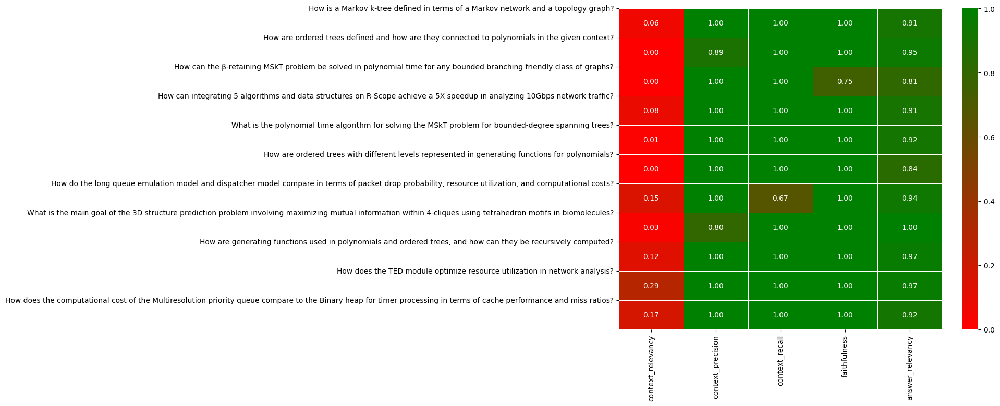

In [39]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# only use if not reading saved csv

# df = result.to_pandas()

heatmap_data = df[['context_relevancy', 'context_precision', 'context_recall', 'faithfulness', 'answer_relevancy']]

cmap = LinearSegmentedColormap.from_list('green_red', ['red', 'green'])

plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, annot=True, fmt=".2f", linewidths=.5, cmap=cmap)

plt.yticks(ticks=range(len(df['question'])), labels=df['question'], rotation=0)

plt.savefig('heatmap.png', dpi=300, bbox_inches='tight')
plt.show()
